<a href="https://colab.research.google.com/github/Artmagic/GP2_team34/blob/main/main_file.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [317]:
!pip install geopandas shapely folium osmnx --quiet

In [ ]:
import pandas as pd

In [319]:
import geopandas as gpd
from shapely.geometry import box
import folium
import osmnx as ox

moscow = ox.geocode_to_gdf("Moscow, Russia")
mkad_box = box(37.35, 55.57, 37.85, 55.93)
moscow_mkad = moscow.intersection(mkad_box)
moscow_mkad = moscow_mkad.to_crs(32637)
def make_grid_meters(bounds, step_m=800):
    minx, miny, maxx, maxy = bounds
    grid_cells = []
    x = minx
    while x < maxx:
        y = miny
        while y < maxy:
            grid_cells.append(box(x, y, x + step_m, y + step_m))
            y += step_m
        x += step_m
    return gpd.GeoDataFrame(geometry=grid_cells, crs="EPSG:32637")
grid = make_grid_meters(moscow_mkad.total_bounds, step_m=800)
moscow_union = moscow_mkad.unary_union
grid_inside = grid[grid.intersects(moscow_union)].reset_index(drop=True)
grid_inside["grid_id"] = range(1, len(grid_inside) + 1)
grid_inside["center_lon"] = grid_inside.centroid.x
grid_inside["center_lat"] = grid_inside.centroid.y
grid_inside = grid_inside.to_crs(4326)
moscow_union = gpd.GeoSeries([moscow_union], crs=32637).to_crs(4326).iloc[0]
m = folium.Map(location=[55.75, 37.62], zoom_start=10)

folium.GeoJson(moscow_union, name="МКАД зона", style_function=lambda x: {
    "color": "red",
    "weight": 2,
}).add_to(m)

folium.GeoJson(grid_inside, name="Grid (800x800 м)", style_function=lambda x: {
    "color": "blue",
    "weight": 1,
    "fillOpacity": 0
}).add_to(m)

folium.LayerControl().add_to(m)
m


In [320]:
grid_inside = grid_inside.reset_index(drop=True)
grid_inside["grid_id"] = range(1, len(grid_inside) + 1)


grid_inside["center_lon"] = grid_inside.centroid.x
grid_inside["center_lat"] = grid_inside.centroid.y
grid_inside = grid_inside.set_index("grid_id")


/tmp/ipython-input-1398222545.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  grid_inside["center_lon"] = grid_inside.centroid.x
/tmp/ipython-input-1398222545.py:6: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  grid_inside["center_lat"] = grid_inside.centroid.y


In [321]:
poi = pd.read_csv("POI.csv")
cian = pd.read_csv("cian_new.csv")
food = pd.read_csv("food_with_ratings_full.csv")
metro = pd.read_csv("moscow_metro_selenium.csv")
metro_flow = pd.read_csv("station_total_passenger_flow.csv")

In [ ]:
del poi["Unnamed: 0"]

In [323]:
del cian["Unnamed: 0"]

In [324]:
# === 1. Преобразуем кафе в GeoDataFrame ===
food_gdf = gpd.GeoDataFrame(
    food,
    geometry=gpd.points_from_xy(food["Longitude_WGS84"], food["Latitude_WGS84"]),
    crs="EPSG:4326"
)

# === 2. Пространственное объединение (кафе → сетка) ===
cafes_in_grid = gpd.sjoin(food_gdf, grid_inside, how="left", predicate="within")

# Проверим, какие колонки создались
print("📋 Колонки после sjoin:", cafes_in_grid.columns.tolist())

# === 3. Определяем, какая колонка отвечает за ID квадрата ===
# (в разных версиях может быть 'index_right', 'index_grid_inside' или просто 'grid_id')
id_col = None
for col in cafes_in_grid.columns:
    if "index_right" in col or "index_grid" in col or col == "grid_id":
        id_col = col
        break

if id_col is None:
    raise ValueError("Не найдена колонка с индексом квадрата после sjoin! Проверь структуру cafes_in_grid.")

# === 4. Считаем количество кафе в каждом квадрате ===
cafe_counts = (
    cafes_in_grid.groupby(id_col)
    .size()
    .reset_index(name="cafe_count")
    .rename(columns={id_col: "grid_id"})
)

# === 5. Объединяем результаты с сеткой ===
grid_inside = grid_inside.merge(cafe_counts, on="grid_id", how="left")

# === 6. Заполняем пропуски нулями ===
grid_inside["cafe_count"] = grid_inside["cafe_count"].fillna(0).astype(int)

# === 7. Проверка результата ===



📋 Колонки после sjoin: ['ID', 'Name', 'global_id', 'IsNetObject', 'OperatingCompany', 'TypeObject', 'AdmArea', 'District', 'Address', 'PublicPhone', 'SeatsCount', 'SocialPrivileges', 'Longitude_WGS84', 'Latitude_WGS84', 'geoData', 'found_name', 'rating', 'reviews_count', 'geometry', 'grid_id', 'center_lon', 'center_lat']


In [ ]:
# Perform a spatial join between grid_inside and food_gdf
grid_with_reviews = gpd.sjoin(grid_inside, food_gdf, how="left", predicate="intersects")

# Group by grid_id and sum the 'reviews_count'
reviews_sum = grid_with_reviews.groupby("grid_id")["reviews_count"].sum().reset_index(name="total_reviews_count")

# Merge the sum of reviews back to the grid_inside GeoDataFrame
grid_inside = grid_inside.merge(reviews_sum, on="grid_id", how="left")

# Fill NaN values with 0 (for grid cells with no cafes)
grid_inside["total_reviews_count"] = grid_inside["total_reviews_count"].fillna(0).astype(int)

# Display the updated grid_inside
display(grid_inside)

In [326]:
grid_inside.describe()

,grid_id,center_lon,center_lat,cafe_count,total_reviews_count
count,1709.000000,1709.000000,1709.000000,1709.000000,1709.000000
mean,855.000000,37.584680,55.738704,11.949093,22379.019895
std,493.490121,0.137943,0.094233,20.962169,44437.489885
min,1.000000,37.343900,55.570561,0.000000,0.000000
25%,428.000000,37.468222,55.659198,0.000000,0.000000
50%,855.000000,37.580980,55.738838,5.000000,1586.000000
75%,1282.000000,37.697103,55.817288,14.000000,24717.000000
max,1709.000000,37.848048,55.932562,252.000000,446715.000000


In [327]:
# === Проверка корректности распределения кафе по квадратам ===

# 1️⃣ Общее количество кафе в исходном датасете
total_cafes_raw = len(food)

# 2️⃣ Общее количество кафе, "разложенных" по квадратам
total_cafes_grid = grid_inside["cafe_count"].sum()

# 3️⃣ Выводим результат
print(f"кафе в исходных данных: {total_cafes_raw}")
print(f"кафе распределено по квадратам: {total_cafes_grid}")


кафе в исходных данных: 22100
кафе распределено по квадратам: 20421


In [328]:
mean_cafe_count = grid_inside["cafe_count"].mean()
median_cafe_count = grid_inside["cafe_count"].median()

print(f"Mean cafe count per grid cell: {mean_cafe_count}")
print(f"Median cafe count per grid cell: {median_cafe_count}")

Mean cafe count per grid cell: 11.949093036863664
Median cafe count per grid cell: 5.0


In [ ]:
import matplotlib.pyplot as plt
grid_inside['cafe_count'].hist(bins=50)
plt.title("Распределение числа кафе в ячейках")
plt.xlabel("cafe_count")
plt.ylabel("Количество ячеек")
#plt.xlim(0, 200)
plt.show()


In [330]:
import geopandas as gpd
import folium

# === 1. Базовая карта ===
m = folium.Map(location=[55.75, 37.62], zoom_start=10, tiles="cartodb positron")

# === 2. Оставляем только квадраты, где есть хотя бы 3 кафе ===
grid_with_cafes = grid_inside[(grid_inside["cafe_count"] > 3) & (grid_inside["cafe_count"] < 100)].copy()

# === 3. Добавляем квадраты с прозрачными границами и мягкой заливкой ===
folium.Choropleth(
    geo_data=grid_with_cafes,
    data=grid_with_cafes,
    columns=["grid_id", "cafe_count"],
    key_on="feature.properties.grid_id",
    fill_color="YlOrRd",         # жёлтый → красный градиент
    fill_opacity=0.45,           # прозрачная заливка
    line_opacity=0,              # полностью убираем линии сетки
    legend_name="Количество кафе"
).add_to(m)

# === 4. Добавляем подсказки при наведении ===
folium.GeoJson(
    grid_with_cafes,
    style_function=lambda x: {
        "fillOpacity": 0,         # сетка прозрачная
        "color": "transparent"
    },
    tooltip=folium.GeoJsonTooltip(
        fields=["grid_id", "cafe_count"],
        aliases=["ID квадрата", "Количество кафе"]
    )
).add_to(m)

# === 5. Показ карты ===
m


In [331]:
# === 1. Пространственное объединение (кафе в квадраты) ===
grid_with_cafe_ratings = gpd.sjoin(grid_inside, food_gdf, how="left", predicate="intersects")

# === 2. Оставляем только те кафе, у которых больше 10 отзывов ===
grid_with_cafe_ratings_filtered = grid_with_cafe_ratings[grid_with_cafe_ratings["reviews_count"] > 10]

# === 3. Считаем средний рейтинг только по этим кафе ===
average_cafe_rating = (
    grid_with_cafe_ratings_filtered
    .groupby("grid_id")["rating"]
    .mean()
    .reset_index(name="average_cafe_rating")
)

# === 4. Объединяем результат обратно с исходной сеткой ===
grid_inside = grid_inside.merge(average_cafe_rating, on="grid_id", how="left")

# === 5. Проверяем результат ===
grid_inside


,grid_id,geometry,center_lon,center_lat,cafe_count,total_reviews_count,average_cafe_rating
0,1,"POLYGON ((37.36281 55.56705, 37.36251 55.57424...",37.356321,55.570561,0,0,NaN
1,2,"POLYGON ((37.36251 55.57424, 37.36221 55.58142...",37.356021,55.577747,0,0,NaN
2,3,"POLYGON ((37.36221 55.58142, 37.36191 55.58861...",37.355720,55.584932,0,0,NaN
3,4,"POLYGON ((37.36191 55.58861, 37.36161 55.5958,...",37.355420,55.592117,24,85377,3.821053
4,5,"POLYGON ((37.36161 55.5958, 37.36131 55.60298,...",37.355119,55.599303,8,5009,4.350000
...,...,...,...,...,...,...,...
1704,1705,"POLYGON ((37.85114 55.78827, 37.85093 55.79546...",37.844656,55.791802,0,0,NaN
1705,1706,"POLYGON ((37.85093 55.79546, 37.85072 55.80264...",37.844443,55.798989,0,0,NaN
1706,1707,"POLYGON ((37.85072 55.80264, 37.8505 55.80983,...",37.844230,55.806176,0,0,NaN
1707,1708,"POLYGON ((37.8505 55.80983, 37.85029 55.81702,...",37.844017,55.813363,0,0,NaN


In [332]:
grid_inside.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1709 entries, 0 to 1708
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   grid_id              1709 non-null   int64   
 1   geometry             1709 non-null   geometry
 2   center_lon           1709 non-null   float64 
 3   center_lat           1709 non-null   float64 
 4   cafe_count           1709 non-null   int64   
 5   total_reviews_count  1709 non-null   int64   
 6   average_cafe_rating  1163 non-null   float64 
dtypes: float64(3), geometry(1), int64(3)
memory usage: 93.6 KB


In [333]:
import geopandas as gpd
import folium
from folium import Choropleth
import numpy as np

# === 1. Убираем пустые значения и обрезаем минимум ===
grid_inside2 = grid_inside.dropna(subset=["average_cafe_rating"]).copy()
grid_inside2["average_cafe_rating"] = grid_inside2["average_cafe_rating"].clip(lower=3.3)

# === 2. Диапазон значений для шкалы ===
vmin = 3.3
vmax = grid_inside2["average_cafe_rating"].max()
thresholds = list(np.linspace(vmin, vmax, num=7).round(2))

# === 3. Базовая карта ===
m = folium.Map(location=[55.75, 37.62], zoom_start=10, tiles="cartodb positron")

# === 4. Хлороплет без синих границ ===
folium.Choropleth(
    geo_data=grid_inside2,
    data=grid_inside2,
    columns=["grid_id", "average_cafe_rating"],
    key_on="feature.properties.grid_id",
    fill_color="RdYlGn",
    fill_opacity=0.8,
    line_opacity=0,       # убираем контуры
    line_color=None,      # полностью без линий
    legend_name="Средний рейтинг кафе",
    threshold_scale=thresholds
).add_to(m)

# === 5. Всплывающие подсказки без обводки ===
folium.GeoJson(
    grid_inside2,
    style_function=lambda x: {"color": "transparent", "weight": 0},
    tooltip=folium.GeoJsonTooltip(
        fields=["grid_id", "average_cafe_rating"],
        aliases=["ID квадрата", "Средний рейтинг"],
        localize=True
    )
).add_to(m)

# === 6. Показ карты ===
m


In [334]:
# --- Преобразуем POI в GeoDataFrame ---
poi_gdf = gpd.GeoDataFrame(
    poi,
    geometry=gpd.points_from_xy(poi["lon"], poi["lat"]),
    crs="EPSG:4326"
)

# --- Функция для подсчёта POI по типу ---
def count_pois_in_grid(grid_gdf, poi_gdf, poi_type):
    # фильтруем нужный тип объектов
    filtered_poi_gdf = poi_gdf[poi_gdf["type"] == poi_type]

    # пространственное объединение (POI → квадрат)
    joined = gpd.sjoin(filtered_poi_gdf, grid_gdf, how="left", predicate="within")

    # определяем имя колонки с индексом квадрата (универсально)
    id_col = None
    for col in joined.columns:
        if "index_right" in col or "index_grid" in col or col == "grid_id":
            id_col = col
            break
    if id_col is None:
        raise ValueError("Не найдена колонка с индексом квадрата после sjoin!")

    # группировка и подсчёт количества объектов
    poi_counts = (
        joined.groupby(id_col)
        .size()
        .reset_index(name=f"{poi_type}_count")
        .rename(columns={id_col: "grid_id"})
    )

    return poi_counts


# --- Подсчитываем школы, университеты и ТЦ ---
school_counts = count_pois_in_grid(grid_inside, poi_gdf, "school")
university_counts = count_pois_in_grid(grid_inside, poi_gdf, "university")
mall_counts = count_pois_in_grid(grid_inside, poi_gdf, "mall")

# --- Объединяем с основной сеткой ---
for df in [school_counts, university_counts, mall_counts]:
    grid_inside = grid_inside.merge(df, on="grid_id", how="left")

# --- Заполняем NaN нулями ---
for col in ["school_count", "university_count", "mall_count"]:
    grid_inside[col] = grid_inside[col].fillna(0).astype(int)

# --- Проверяем результат ---
grid_inside


,grid_id,geometry,center_lon,center_lat,cafe_count,total_reviews_count,average_cafe_rating,school_count,university_count,mall_count
0,1,"POLYGON ((37.36281 55.56705, 37.36251 55.57424...",37.356321,55.570561,0,0,NaN,1,0,0
1,2,"POLYGON ((37.36251 55.57424, 37.36221 55.58142...",37.356021,55.577747,0,0,NaN,0,0,0
2,3,"POLYGON ((37.36221 55.58142, 37.36191 55.58861...",37.355720,55.584932,0,0,NaN,0,0,1
3,4,"POLYGON ((37.36191 55.58861, 37.36161 55.5958,...",37.355420,55.592117,24,85377,3.821053,1,0,0
4,5,"POLYGON ((37.36161 55.5958, 37.36131 55.60298,...",37.355119,55.599303,8,5009,4.350000,0,0,1
...,...,...,...,...,...,...,...,...,...,...
1704,1705,"POLYGON ((37.85114 55.78827, 37.85093 55.79546...",37.844656,55.791802,0,0,NaN,0,0,0
1705,1706,"POLYGON ((37.85093 55.79546, 37.85072 55.80264...",37.844443,55.798989,0,0,NaN,0,0,0
1706,1707,"POLYGON ((37.85072 55.80264, 37.8505 55.80983,...",37.844230,55.806176,0,0,NaN,0,0,0
1707,1708,"POLYGON ((37.8505 55.80983, 37.85029 55.81702,...",37.844017,55.813363,0,0,NaN,0,0,0


In [ ]:
# Create a new column 'poi_count' by summing the individual counts
grid_inside["poi_count"] = grid_inside["school_count"] + grid_inside["university_count"] + grid_inside["mall_count"]



In [336]:
import geopandas as gpd
import folium

# === 1. Что визуализируем ===
# Выбери нужную категорию: "school_count", "university_count", "mall_count"
poi_column = "poi_count"
legend_title = "Учебные заведения и тц"

# === 2. Базовая карта ===
m = folium.Map(location=[55.75, 37.62], zoom_start=10, tiles="cartodb positron")

# === 3. Фильтрация по диапазону значений, чтобы убрать выбросы ===
grid_filtered = grid_inside[(grid_inside[poi_column] > 0) & (grid_inside[poi_column] < 50)].copy()

# === 4. Добавляем полупрозрачную заливку ===
folium.Choropleth(
    geo_data=grid_filtered,
    data=grid_filtered,
    columns=["grid_id", poi_column],
    key_on="feature.properties.grid_id",
    fill_color="RdYlGn",        # сине-зелёный градиент
    fill_opacity=0.45,          # полупрозрачная заливка
    line_opacity=0,             # без видимых границ
    highlight=True,
    legend_name=legend_title
).add_to(m)

# === 5. Подсказки при наведении ===
folium.GeoJson(
    grid_filtered,
    style_function=lambda x: {
        "fillOpacity": 0,
        "color": "transparent"
    },
    tooltip=folium.GeoJsonTooltip(
        fields=["grid_id", poi_column],
        aliases=["ID квадрата", legend_title]
    )
).add_to(m)

# === 6. Отображение карты ===
m


In [337]:
# Create a new column 'poi_count' by summing the individual counts
grid_inside["poi_count"] = grid_inside["school_count"] + grid_inside["university_count"] + grid_inside["mall_count"]

# Display the updated grid_inside GeoDataFrame with the new 'poi_count' column
grid_inside

,grid_id,geometry,center_lon,center_lat,cafe_count,total_reviews_count,average_cafe_rating,school_count,university_count,mall_count,poi_count
0,1,"POLYGON ((37.36281 55.56705, 37.36251 55.57424...",37.356321,55.570561,0,0,NaN,1,0,0,1
1,2,"POLYGON ((37.36251 55.57424, 37.36221 55.58142...",37.356021,55.577747,0,0,NaN,0,0,0,0
2,3,"POLYGON ((37.36221 55.58142, 37.36191 55.58861...",37.355720,55.584932,0,0,NaN,0,0,1,1
3,4,"POLYGON ((37.36191 55.58861, 37.36161 55.5958,...",37.355420,55.592117,24,85377,3.821053,1,0,0,1
4,5,"POLYGON ((37.36161 55.5958, 37.36131 55.60298,...",37.355119,55.599303,8,5009,4.350000,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...
1704,1705,"POLYGON ((37.85114 55.78827, 37.85093 55.79546...",37.844656,55.791802,0,0,NaN,0,0,0,0
1705,1706,"POLYGON ((37.85093 55.79546, 37.85072 55.80264...",37.844443,55.798989,0,0,NaN,0,0,0,0
1706,1707,"POLYGON ((37.85072 55.80264, 37.8505 55.80983,...",37.844230,55.806176,0,0,NaN,0,0,0,0
1707,1708,"POLYGON ((37.8505 55.80983, 37.85029 55.81702,...",37.844017,55.813363,0,0,NaN,0,0,0,0


In [338]:
# === 1. Отфильтровываем только сетевые кафе ===
chain_cafes_gdf = food_gdf[food_gdf["IsNetObject"].astype(str).str.lower().isin(["да", "yes", "true"])].copy()

# === 2. Пространственное объединение (кафе → квадрат) ===
chain_joined = gpd.sjoin(chain_cafes_gdf, grid_inside, how="left", predicate="within")

# === 3. Находим имя колонки с индексом квадрата (универсально для разных версий GeoPandas) ===
id_col = None
for col in chain_joined.columns:
    if "index_right" in col or "index_grid" in col or col == "grid_id":
        id_col = col
        break

if id_col is None:
    raise ValueError("Не найдена колонка с индексом квадрата после sjoin!")

# === 4. Считаем количество сетевых кафе по каждому квадрату ===
chain_cafe_counts = (
    chain_joined.groupby(id_col)
    .size()
    .reset_index(name="chain_cafe_count")
    .rename(columns={id_col: "grid_id"})
)

# === 5. Объединяем результаты с основной сеткой ===
grid_inside = grid_inside.merge(chain_cafe_counts, on="grid_id", how="left")

# === 6. Заполняем пропуски нулями (если нет сетевых кафе в квадрате) ===
grid_inside["chain_cafe_count"] = grid_inside["chain_cafe_count"].fillna(0).astype(int)

# === 7. Проверяем результат ===
print(grid_inside["chain_cafe_count"].describe())



count    1709.000000
mean        2.213575
std         4.343226
min         0.000000
25%         0.000000
50%         0.000000
75%         2.000000
max        37.000000
Name: chain_cafe_count, dtype: float64


In [ ]:
grid_inside.describe()

In [340]:
from shapely.geometry import Point
import numpy as np

# Convert metro DataFrame to GeoDataFrame
metro_gdf = gpd.GeoDataFrame(
    metro, geometry=gpd.points_from_xy(metro.longitude, metro.latitude), crs="EPSG:4326"
)

# Convert grid_inside centroids to a GeoDataFrame for distance calculation
grid_centroids_gdf = gpd.GeoDataFrame(
    grid_inside, geometry=gpd.points_from_xy(grid_inside.center_lon, grid_inside.center_lat), crs="EPSG:4326"
)

# Re-project to a projected CRS (UTM Zone 37N for Moscow) for accurate distance calculation in meters
metro_gdf_projected = metro_gdf.to_crs(32637)
grid_centroids_gdf_projected = grid_centroids_gdf.to_crs(32637)


# Function to calculate the distance to the nearest metro station
def nearest_metro_distance(point, metro_gdf):
    distances = metro_gdf.distance(point)
    return distances.min()

# Apply the function to each grid cell centroid using the projected data
# Note: This can be computationally intensive for large datasets
grid_inside["distance_to_metro"] = grid_centroids_gdf_projected.geometry.apply(
    lambda x: nearest_metro_distance(x, metro_gdf_projected)
)

# Display the updated grid_inside GeoDataFrame with distance to metro
grid_inside

,grid_id,geometry,center_lon,center_lat,cafe_count,total_reviews_count,average_cafe_rating,school_count,university_count,mall_count,poi_count,chain_cafe_count,distance_to_metro
0,1,"POLYGON ((37.36281 55.56705, 37.36251 55.57424...",37.356321,55.570561,0,0,NaN,1,0,0,1,0,4714.391810
1,2,"POLYGON ((37.36251 55.57424, 37.36221 55.58142...",37.356021,55.577747,0,0,NaN,0,0,0,0,0,4183.474525
2,3,"POLYGON ((37.36221 55.58142, 37.36191 55.58861...",37.355720,55.584932,0,0,NaN,0,0,1,1,8,3749.323680
3,4,"POLYGON ((37.36191 55.58861, 37.36161 55.5958,...",37.355420,55.592117,24,85377,3.821053,1,0,0,1,1,3448.680474
4,5,"POLYGON ((37.36161 55.5958, 37.36131 55.60298,...",37.355119,55.599303,8,5009,4.350000,0,0,1,1,3,3318.036462
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1704,1705,"POLYGON ((37.85114 55.78827, 37.85093 55.79546...",37.844656,55.791802,0,0,NaN,0,0,0,0,0,2863.532024
1705,1706,"POLYGON ((37.85093 55.79546, 37.85072 55.80264...",37.844443,55.798989,0,0,NaN,0,0,0,0,0,2868.569716
1706,1707,"POLYGON ((37.85072 55.80264, 37.8505 55.80983,...",37.844230,55.806176,0,0,NaN,0,0,0,0,0,2882.591390
1707,1708,"POLYGON ((37.8505 55.80983, 37.85029 55.81702,...",37.844017,55.813363,0,0,NaN,0,0,0,0,0,2880.517609


In [341]:
import numpy as np
import folium

# === 1. Убираем пропуски ===
grid_inside = grid_inside.dropna(subset=["distance_to_metro"]).copy()

# === 2. Нормализуем близость: 0 (далеко) → 1 (близко)
max_dist = grid_inside["distance_to_metro"].max()
min_dist = grid_inside["distance_to_metro"].min()
grid_inside["proximity_to_metro"] = 1 - (grid_inside["distance_to_metro"] - min_dist) / (max_dist - min_dist)

# === 3. Строим карту ===
m = folium.Map(location=[55.75, 37.62], zoom_start=10, tiles="cartodb positron")

# === 3.1. Отрисовываем квадраты без контурных линий ===
folium.Choropleth(
    geo_data=grid_inside,
    data=grid_inside,
    columns=["grid_id", "proximity_to_metro"],
    key_on="feature.properties.grid_id",
    fill_color="Greens",
    fill_opacity=0.8,
    line_opacity=0,        # отключаем границы
    line_color=None,       # полностью убираем линии
    legend_name="Близость к метро (1 — очень близко)",
    nan_fill_color="white",
    highlight=False
).add_to(m)

# === 4. Всплывающие подсказки ===
folium.GeoJson(
    grid_inside,
    style_function=lambda x: {"color": "transparent", "weight": 0},  # никаких линий при наведении
    tooltip=folium.GeoJsonTooltip(
        fields=["grid_id", "distance_to_metro", "proximity_to_metro"],
        aliases=["ID квадрата", "Расстояние до метро (м)", "Близость (0–1)"],
        localize=True
    )
).add_to(m)

m



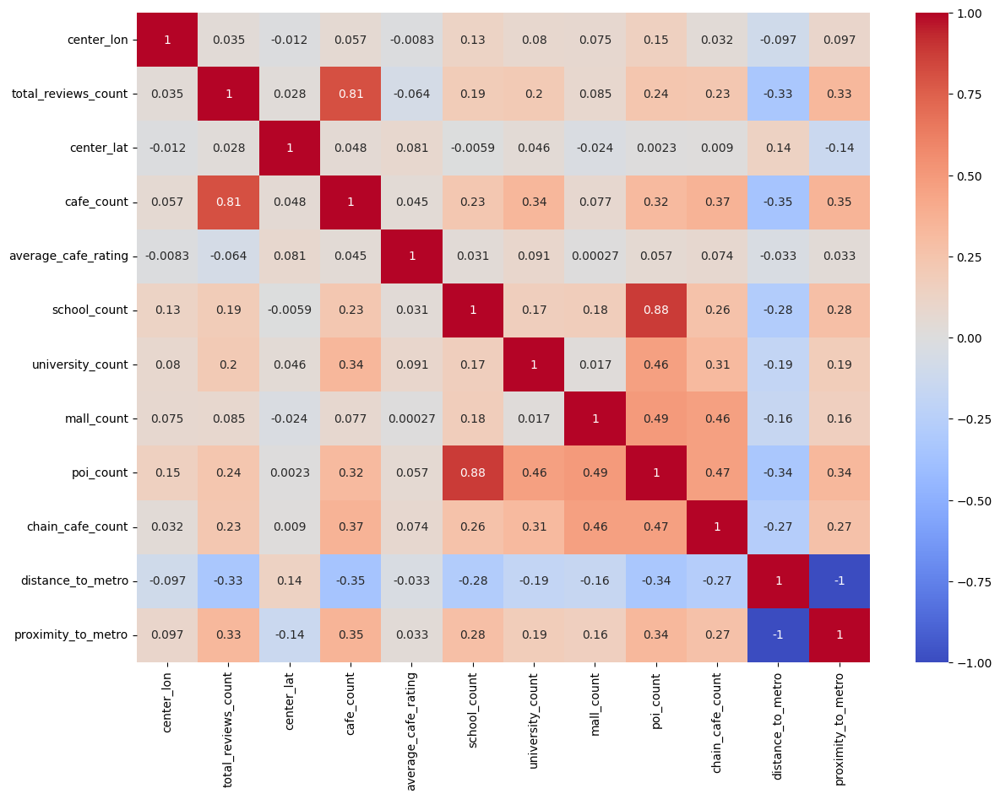

In [342]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(14, 10))
features = ['center_lon', 'total_reviews_count', 'center_lat', 'cafe_count', 'average_cafe_rating', 'school_count', 'university_count', 'mall_count', 'poi_count', 'chain_cafe_count', 'distance_to_metro', 'proximity_to_metro']
#corrs = grid_inside.corr()["average_cafe_rating"].sort_values(ascending=False)

#print(corrs)
sns.heatmap(grid_inside[features].corr(), annot=True, cmap="coolwarm")
plt.show()

In [343]:
# Display the data types of all columns in the grid_inside DataFrame
print(grid_inside.dtypes)

grid_id                   int64
geometry               geometry
center_lon              float64
center_lat              float64
cafe_count                int64
total_reviews_count       int64
average_cafe_rating     float64
school_count              int64
university_count          int64
mall_count                int64
poi_count                 int64
chain_cafe_count          int64
distance_to_metro       float64
proximity_to_metro      float64
dtype: object


In [344]:
# Display the names of all columns in the grid_inside DataFrame
print(grid_inside.columns.tolist())

['grid_id', 'geometry', 'center_lon', 'center_lat', 'cafe_count', 'total_reviews_count', 'average_cafe_rating', 'school_count', 'university_count', 'mall_count', 'poi_count', 'chain_cafe_count', 'distance_to_metro', 'proximity_to_metro']


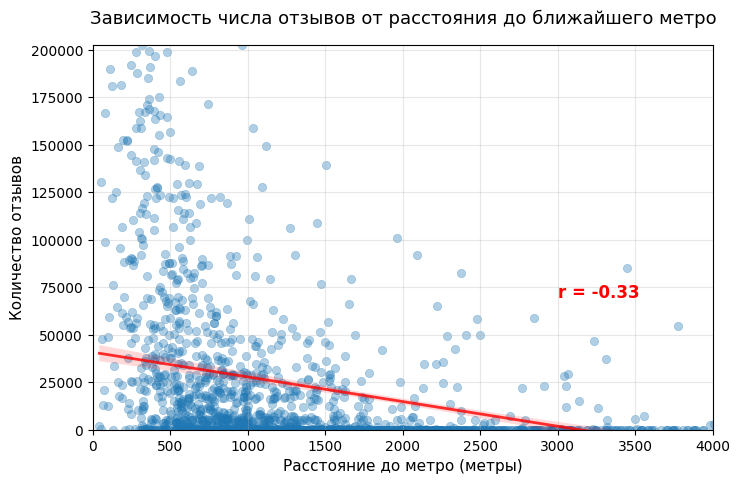

In [345]:
import seaborn as sns
import matplotlib.pyplot as plt

# Строим scatter plot
plt.figure(figsize=(8, 5))
sns.scatterplot(
    data=grid_inside,
    x="distance_to_metro",
    y="total_reviews_count",
    alpha=0.35,
    color="#1f77b4",
    edgecolor=None
)

# Добавляем линию тренда (регрессия)
sns.regplot(
    data=grid_inside,
    x="distance_to_metro",
    y="total_reviews_count",
    scatter=False,
    color="red",
    line_kws={"linewidth": 2, "alpha": 0.8}
)

# Настройка внешнего вида
plt.title("Зависимость числа отзывов от расстояния до ближайшего метро", fontsize=13, pad=15)
plt.xlabel("Расстояние до метро (метры)", fontsize=11)
plt.ylabel("Количество отзывов", fontsize=11)
plt.xlim(0, 4000)
plt.ylim(0, grid_inside["total_reviews_count"].quantile(0.99))  # чтобы убрать экстремальные выбросы
plt.grid(True, alpha=0.3)

# Добавляем значение корреляции на график
corr = grid_inside["distance_to_metro"].corr(grid_inside["total_reviews_count"])
plt.text(3000, grid_inside["total_reviews_count"].quantile(0.9),
         f"r = {corr:.2f}",
         fontsize=12, color="red", weight="bold")

plt.show()


/tmp/ipython-input-1588049069.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='university_count', y='total_reviews_count', data=grid_inside, palette='Set2')


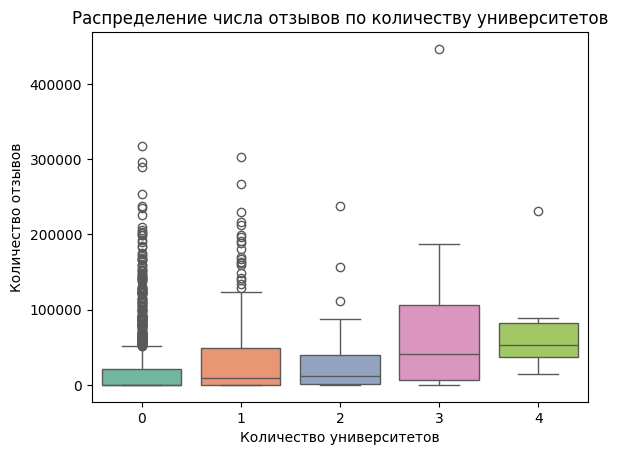

In [346]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.boxplot(x='university_count', y='total_reviews_count', data=grid_inside, palette='Set2')
#sns.stripplot(x='university_count', y='total_reviews_count', data=grid_inside, color='black', alpha=0.4, jitter=True)
plt.title("Распределение числа отзывов по количеству университетов")
plt.xlabel("Количество университетов")
plt.ylabel("Количество отзывов")
#plt.yscale('log')  # логарифм, чтобы убрать "вытянутый" хвост

plt.show()

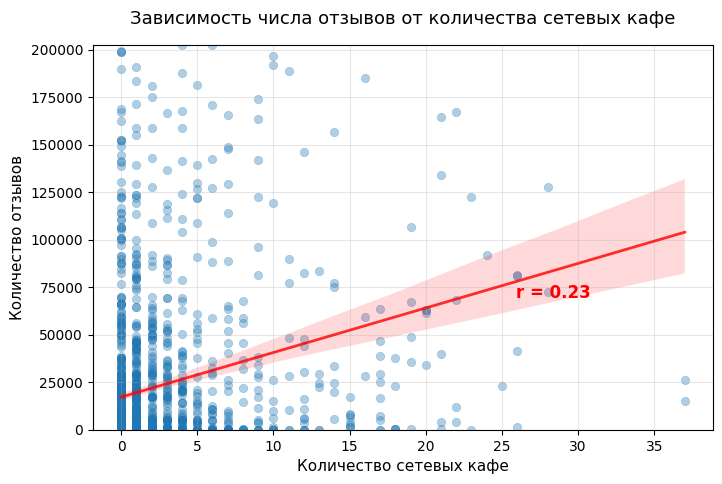

In [347]:
import seaborn as sns
import matplotlib.pyplot as plt

# Строим scatter plot
plt.figure(figsize=(8, 5))
sns.scatterplot(
    data=grid_inside,
    x="chain_cafe_count",
    y="total_reviews_count",
    alpha=0.35,
    color="#1f77b4",
    edgecolor=None
)

# Добавляем линию тренда (регрессия)
sns.regplot(
    data=grid_inside,
    x="chain_cafe_count",
    y="total_reviews_count",
    scatter=False,
    color="red",
    line_kws={"linewidth": 2, "alpha": 0.8}
)

# Настройка внешнего вида
plt.title("Зависимость числа отзывов от количества сетевых кафе", fontsize=13, pad=15)
plt.xlabel("Количество сетевых кафе", fontsize=11)
plt.ylabel("Количество отзывов", fontsize=11)
plt.ylim(0, grid_inside["total_reviews_count"].quantile(0.99))  # чтобы убрать экстремальные выбросы
plt.grid(True, alpha=0.3)

# Добавляем значение корреляции на график
corr = grid_inside["chain_cafe_count"].corr(grid_inside["total_reviews_count"])
plt.text(grid_inside["chain_cafe_count"].max() * 0.7, grid_inside["total_reviews_count"].quantile(0.9),
         f"r = {corr:.2f}",
         fontsize=12, color="red", weight="bold")

plt.show()

In [348]:
import pandas as pd
import geopandas as gpd
from shapely import wkt
from shapely.geometry import Point
from tqdm import tqdm
import numpy as np

df = pd.read_csv("grid_with_walkability_and_parkings.csv")

if "geometry" not in df.columns:
    grid_inside = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df.center_lon, df.center_lat),
        crs="EPSG:4326"
    )
else:
    df["geometry"] = df["geometry"].apply(wkt.loads)
    grid_inside = gpd.GeoDataFrame(df, geometry="geometry", crs="EPSG:4326")

print(f"Загружено квадратов: {len(grid_inside)}")

# === 2. Загружаем станции метро с потоком ===
metro = pd.read_csv("metro_stations_with_passenger_flow.csv")

# Добавляем среднесуточный поток
metro["metro_flow"] = (metro["IncomingPassengers"] + metro["OutgoingPassengers"]) / 365

metro_gdf = gpd.GeoDataFrame(
    metro,
    geometry=gpd.points_from_xy(metro.longitude, metro.latitude),
    crs="EPSG:4326"
)

print(f"Станций метро: {len(metro_gdf)}")
metro_gdf

Загружено квадратов: 1709
Станций метро: 264


,station,latitude,longitude,IncomingPassengers,OutgoingPassengers,metro_flow,geometry
0,бульвар рокоссовского,55.814800,37.734200,11923084.0,11973345.0,65469.668493,POINT (37.7342 55.8148)
1,черкизовская,55.803800,37.744800,6768663.0,5918510.0,34759.378082,POINT (37.7448 55.8038)
2,преображенская площадь,55.796300,37.715100,14787398.0,14953056.0,81480.695890,POINT (37.7151 55.7963)
3,сокольники,55.788800,37.680200,12683076.0,13006092.0,70381.282192,POINT (37.6802 55.7888)
4,красносельская,55.780100,37.667300,7035502.0,7207647.0,39022.326027,POINT (37.6673 55.7801)
...,...,...,...,...,...,...,...
259,угрешская,55.715477,37.687445,1848391.0,1951249.0,10409.972603,POINT (37.68744 55.71548)
260,улица академика королёва,55.821634,37.615863,62826.0,55920.0,325.331507,POINT (37.61586 55.82163)
261,улица сергея эйзенштейна,55.829641,37.649484,87429.0,76802.0,449.947945,POINT (37.64948 55.82964)
262,шелепиха,55.757300,37.525629,6152618.0,6367328.0,34301.221918,POINT (37.52563 55.7573)


In [349]:
from shapely.ops import nearest_points

grid_m = grid_inside.to_crs(32637)
metro_m = metro_gdf.to_crs(32637)

def get_nearest_metro(row, metro_gdf):
    nearest_geom = metro_gdf.distance(row.geometry).idxmin()
    nearest_station = metro_gdf.loc[nearest_geom]
    return pd.Series({
        "nearest_metro": nearest_station["station"],
        "distance_to_metro_new": row.geometry.distance(nearest_station.geometry),
        "metro_flow": nearest_station["metro_flow"]
    })

tqdm.pandas(desc="Считаем расстояния")
nearest_data = grid_m.progress_apply(lambda row: get_nearest_metro(row, metro_m), axis=1)

# === 4. Объединяем с сеткой ===
grid_inside = pd.concat([grid_inside, nearest_data], axis=1)
grid_inside

Считаем расстояния: 100%|██████████| 1709/1709 [00:06<00:00, 282.68it/s] 


,grid_id,geometry,center_lon,center_lat,cafe_count,total_reviews_count,average_cafe_rating,school_count,university_count,mall_count,...,distance_to_metro,proximity_to_metro,foot_traffic_count,walkable_length_m,walkability_index,parking_count,parking_density,nearest_metro,distance_to_metro_new,metro_flow
0,1,"POLYGON ((37.36281 55.56705, 37.36251 55.57424...",37.356321,55.570561,0,0,0.000000,1,0,0,...,4714.391810,0.440214,0,16532.241693,0.186,2,0.012,филатов луг,4148.712190,40730.665753
1,2,"POLYGON ((37.36251 55.57424, 37.36221 55.58142...",37.356021,55.577747,0,0,0.000000,0,0,0,...,4183.474525,0.503809,0,23803.054527,0.267,0,0.000,филатов луг,3623.229461,40730.665753
2,3,"POLYGON ((37.36221 55.58142, 37.36191 55.58861...",37.355720,55.584932,0,0,0.000000,0,0,1,...,3749.323680,0.555813,0,13965.927756,0.157,0,0.000,филатов луг,3213.062498,40730.665753
3,4,"POLYGON ((37.36191 55.58861, 37.36161 55.5958,...",37.355420,55.592117,24,85377,3.821053,1,0,0,...,3448.680474,0.591825,0,11419.091284,0.128,2,0.012,филатов луг,2966.437173,40730.665753
4,5,"POLYGON ((37.36161 55.5958, 37.36131 55.60298,...",37.355119,55.599303,8,5009,4.350000,0,0,1,...,3318.036462,0.607474,0,53829.950708,0.605,50,0.307,филатов луг,2914.528894,40730.665753
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1704,1705,"POLYGON ((37.85114 55.78827, 37.85093 55.79546...",37.844656,55.791802,0,0,0.000000,0,0,0,...,2863.532024,0.661916,0,10719.362850,0.120,1,0.006,измайлово,1047.785822,19990.164384
1705,1706,"POLYGON ((37.85093 55.79546, 37.85072 55.80264...",37.844443,55.798989,0,0,0.000000,0,0,0,...,2868.569716,0.661312,0,17610.686068,0.198,3,0.018,измайлово,1061.166212,19990.164384
1706,1707,"POLYGON ((37.85072 55.80264, 37.8505 55.80983,...",37.844230,55.806176,0,0,0.000000,0,0,0,...,2882.591390,0.659633,0,36400.697089,0.409,8,0.049,измайлово,1426.480991,19990.164384
1707,1708,"POLYGON ((37.8505 55.80983, 37.85029 55.81702,...",37.844017,55.813363,0,0,0.000000,0,0,0,...,2880.517609,0.659881,0,21219.880908,0.238,4,0.025,измайлово,2055.145325,19990.164384


In [ ]:
import numpy as np

# Нормализация признаков (0–1)
for col in ["metro_flow", "distance_to_metro_new", "parking_count", "poi_count"]:
    grid_inside[col + "_norm"] = (
        (grid_inside[col] - grid_inside[col].min()) / (grid_inside[col].max() - grid_inside[col].min())
    )

# Логарифмируем расстояние (чтобы влияние метро было реалистичным)
grid_inside["distance_to_metro_log"] = np.log1p(grid_inside["distance_to_metro_new_norm"])

print("Признаки нормализованы и готовы к расчёту.")

In [351]:
best_r, best_params = 0, None

# Перебираем веса в разумных пределах
for alpha in np.linspace(0.4, 0.8, 9):   # влияние метро
    for beta in np.linspace(0.1, 0.4, 7):  # влияние парковок
        for gamma in np.linspace(0.1, 0.4, 7):  # влияние POI
            ft = (
                alpha * (grid_inside["metro_flow_norm"] / (grid_inside["distance_to_metro_log"] + 0.01)) +
                beta * grid_inside["parking_count_norm"] +
                gamma * np.sqrt(grid_inside["poi_count_norm"])
            )
            r = ft.corr(grid_inside["total_reviews_count"])
            if r > best_r:
                best_r, best_params = r, (alpha, beta, gamma)

# Применяем лучшие параметры
alpha, beta, gamma = best_params
grid_inside["daily_foot_traffic"] = (
    alpha * (grid_inside["metro_flow_norm"] / (grid_inside["distance_to_metro_log"] + 0.01)) +
    beta * grid_inside["parking_count_norm"] +
    gamma * np.sqrt(grid_inside["poi_count_norm"])
).fillna(0)

print(f"Лучшая корреляция с total_reviews_count: {best_r:.3f}")
print(f"Оптимальные веса: α={alpha:.2f}, β={beta:.2f}, γ={gamma:.2f}")

Лучшая корреляция с total_reviews_count: 0.610
Оптимальные веса: α=0.40, β=0.40, γ=0.40


In [352]:
# Пересчёт daily_foot_traffic в реальные значения (люди в день)

# Берём максимальный поток метро (уже среднесуточный, т.к. metro_flow = (In + Out) / 365)
max_metro_flow_daily = grid_inside["metro_flow"].max()*1.5

# Масштабируем индекс под реальные значения
grid_inside["daily_foot_traffic_real"] = (
    grid_inside["daily_foot_traffic"] / grid_inside["daily_foot_traffic"].max()
) * max_metro_flow_daily

print("Поток в людях в день рассчитан:")
display(grid_inside[["grid_id", "daily_foot_traffic", "daily_foot_traffic_real"]].head())

grid_inside["daily_foot_traffic_real"].describe().round(0)

Поток в людях в день рассчитан:


,grid_id,daily_foot_traffic,daily_foot_traffic_real
0,1,0.294547,2333.621737
1,2,0.199270,1578.769336
2,3,0.330778,2620.674114
3,4,0.350694,2778.468516
4,5,0.471957,3739.204840


,daily_foot_traffic_real
count,1709.0
mean,22703.0
std,33876.0
min,0.0
25%,4286.0
50%,9383.0
75%,24250.0
max,317144.0


In [353]:
grid_inside[["distance_to_metro_new", "parking_count", "poi_count", "metro_flow"]].describe()

,distance_to_metro_new,parking_count,poi_count,metro_flow
count,1709.000000,1709.000000,1709.000000,1704.000000
mean,903.900454,10.307197,1.436513,53015.898775
std,1090.666826,12.813372,1.759611,34070.441083
min,0.000000,0.000000,0.000000,0.000000
25%,166.622004,2.000000,0.000000,26741.632877
50%,568.811173,7.000000,1.000000,49574.547945
75%,1206.870812,14.000000,2.000000,74883.136986
max,7920.191620,163.000000,13.000000,211429.178082


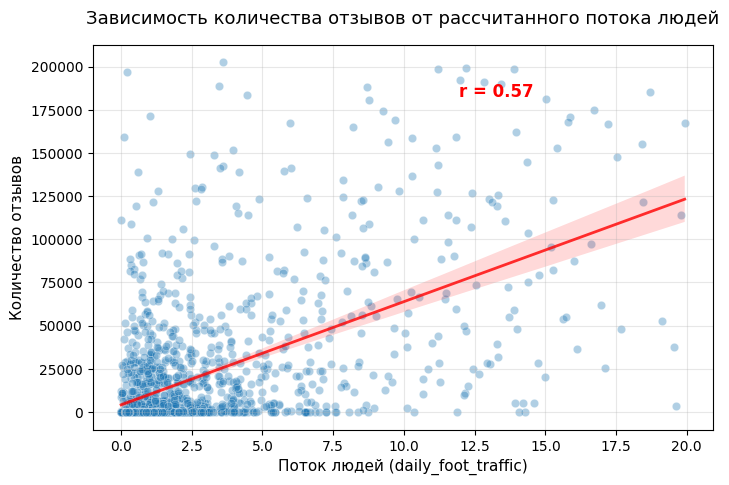

Коэффициент корреляции: 0.568


In [354]:
import seaborn as sns
import matplotlib.pyplot as plt

subset = grid_inside[
    (grid_inside["daily_foot_traffic"] > 0) &
    (grid_inside["daily_foot_traffic"] < grid_inside["daily_foot_traffic"].quantile(0.99)) &
    (grid_inside["total_reviews_count"] < grid_inside["total_reviews_count"].quantile(0.99))
]

plt.figure(figsize=(8, 5))
sns.scatterplot(
    data=subset,
    x="daily_foot_traffic",
    y="total_reviews_count",
    alpha=0.35,
    color="#1f77b4"
)

sns.regplot(
    data=subset,
    x="daily_foot_traffic",
    y="total_reviews_count",
    scatter=False,
    color="red",
    line_kws={"linewidth": 2, "alpha": 0.8}
)

corr = subset["daily_foot_traffic"].corr(subset["total_reviews_count"])

plt.title("Зависимость количества отзывов от рассчитанного потока людей", fontsize=13, pad=15)
plt.xlabel("Поток людей (daily_foot_traffic)", fontsize=11)
plt.ylabel("Количество отзывов", fontsize=11)
plt.text(
    subset["daily_foot_traffic"].max() * 0.6,
    subset["total_reviews_count"].max() * 0.9,
    f"r = {corr:.2f}",
    fontsize=12,
    color="red",
    weight="bold"
)
plt.grid(True, alpha=0.3)
plt.show()

print(f"Коэффициент корреляции: {corr:.3f}")


In [355]:
print(grid_inside.columns.tolist())

['grid_id', 'geometry', 'center_lon', 'center_lat', 'cafe_count', 'total_reviews_count', 'average_cafe_rating', 'school_count', 'university_count', 'mall_count', 'poi_count', 'chain_cafe_count', 'distance_to_metro', 'proximity_to_metro', 'foot_traffic_count', 'walkable_length_m', 'walkability_index', 'parking_count', 'parking_density', 'nearest_metro', 'distance_to_metro_new', 'metro_flow', 'metro_flow_norm', 'distance_to_metro_new_norm', 'parking_count_norm', 'poi_count_norm', 'distance_to_metro_log', 'daily_foot_traffic', 'daily_foot_traffic_real']


Топ 10 корреляций среди выбранных признаков:


,Feature1,Feature2,Correlation
130,poi_count,poi_count_norm,1.000000
161,distance_to_metro,proximity_to_metro,-1.000000
243,parking_density,parking_count_norm,0.999995
264,distance_to_metro_new,distance_to_metro_log,0.995003
184,proximity_to_metro,distance_to_metro_new,-0.973667
...,...,...,...
81,university_count,mall_count,0.016730
185,proximity_to_metro,metro_flow,0.012694
166,distance_to_metro,metro_flow,-0.012694
105,mall_count,foot_traffic_count,0.012051


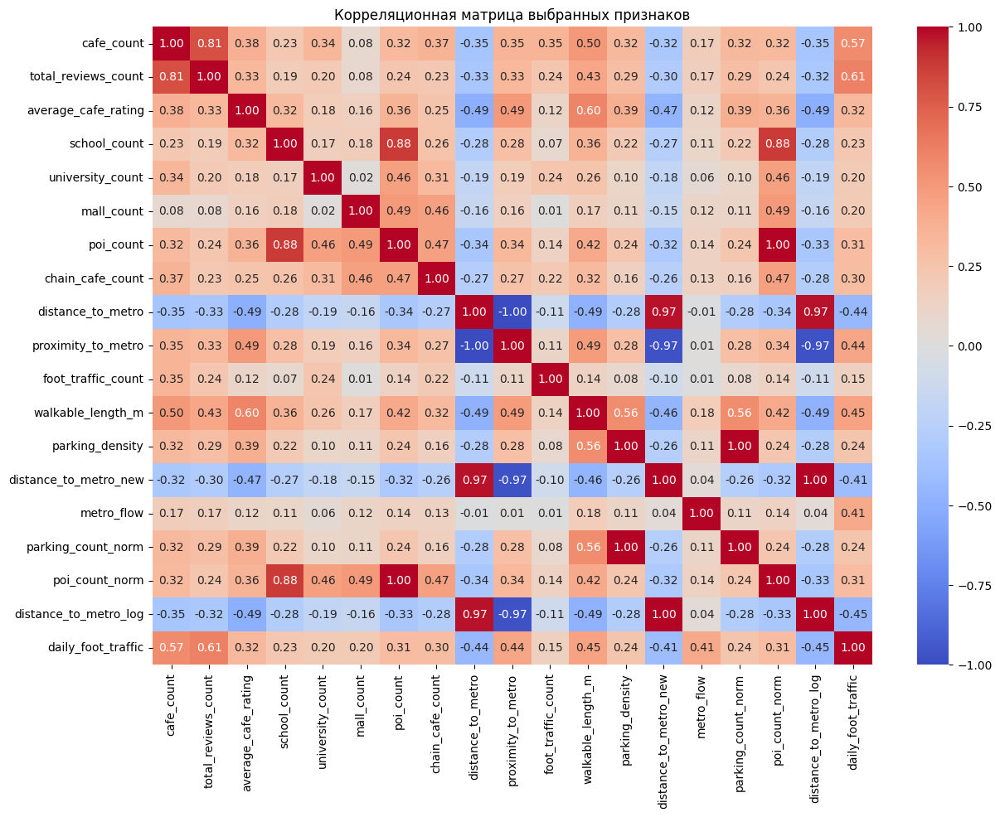

In [356]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

features = ['cafe_count', 'total_reviews_count', 'average_cafe_rating', 'school_count', 'university_count', 'mall_count', 'poi_count', 'chain_cafe_count', 'distance_to_metro', 'proximity_to_metro', 'foot_traffic_count', 'walkable_length_m', 'parking_density', 'distance_to_metro_new', 'metro_flow', 'parking_count_norm', 'poi_count_norm', 'distance_to_metro_log', 'daily_foot_traffic']

# Calculate the correlation matrix for the specified features
correlation_matrix = grid_inside[features].corr()

# Unstack the correlation matrix to get pairs of features and their correlations
correlation_pairs = correlation_matrix.stack()

# Convert to DataFrame and reset index
correlation_pairs_df = correlation_pairs.reset_index()
correlation_pairs_df.columns = ['Feature1', 'Feature2', 'Correlation']

# Filter out self-correlations (where Feature1 == Feature2)
correlation_pairs_df = correlation_pairs_df[correlation_pairs_df['Feature1'] != correlation_pairs_df['Feature2']]

# Remove duplicate pairs (e.g., A-B and B-A)
correlation_pairs_df['abs_correlation'] = correlation_pairs_df['Correlation'].abs()
correlation_pairs_df['sorted_features'] = correlation_pairs_df.apply(lambda row: tuple(sorted([row['Feature1'], row['Feature2']])), axis=1)
correlation_pairs_df = correlation_pairs_df.drop_duplicates(subset=['sorted_features'])

# Sort by absolute correlation in descending order
top_correlations = correlation_pairs_df.sort_values(by='abs_correlation', ascending=False)

print("Топ 10 корреляций среди выбранных признаков:")
display(top_correlations[['Feature1', 'Feature2', 'Correlation']])

# Optionally, you can keep the heatmap visualization as well
plt.figure(figsize=(14, 10))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Корреляционная матрица выбранных признаков")
plt.show()

In [357]:
# Посмотрим корреляцию с числом отзывов (или можно с рейтингом)
target = "total_reviews_count"

corrs = {}
for col in ["average_cafe_rating", "daily_foot_traffic_real", "poi_count", "parking_count", "chain_cafe_count"]:
    corr = grid_inside[[col, target]].corr().iloc[0,1]
    corrs[col] = abs(corr)  # берём модуль, чтобы не зависело от направления

# Нормируем, чтобы сумма = 1
total = sum(corrs.values())
weights_corr = {k: round(v/total, 3) for k,v in corrs.items()}

print("📊 Веса на основе корреляции:")
for k,v in weights_corr.items():
    print(f"{k}: {v}")

📊 Веса на основе корреляции:
average_cafe_rating: 0.195
daily_foot_traffic_real: 0.358
poi_count: 0.141
parking_count: 0.171
chain_cafe_count: 0.134


In [358]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

X = grid_inside[["average_cafe_rating", "daily_foot_traffic_real","poi_count", "parking_count", "chain_cafe_count"]].fillna(0)

X_scaled = StandardScaler().fit_transform(X)
pca = PCA(n_components=3)
pca.fit(X_scaled)

importance = abs(pca.components_[0])
importance = importance / importance.sum()

weights_pca = dict(zip(X.columns, importance.round(3)))
print("📈 Веса по PCA:", weights_pca)

📈 Веса по PCA: {'average_cafe_rating': np.float64(0.212), 'daily_foot_traffic_real': np.float64(0.195), 'poi_count': np.float64(0.221), 'parking_count': np.float64(0.175), 'chain_cafe_count': np.float64(0.198)}


In [ ]:
cian_metro1 = pd.read_csv("cian_metro1.csv")
cian_metro2 = pd.read_csv("cian_metro2.csv")
cian_metro3 = pd.read_csv("cian_metro3.csv")
cian_metro4 = pd.read_csv("cian_metro4.csv")
cian_metro5 = pd.read_csv("cian_metro5.csv")

In [360]:
cian_metro1.drop_duplicates(subset = ["link"], inplace=True)
cian_metro2.drop_duplicates(subset = ["link"], inplace=True)
cian_metro3.drop_duplicates(subset = ["link"], inplace=True)
cian_metro4.drop_duplicates(subset = ["link"], inplace=True)
cian_metro5.drop_duplicates(subset = ["link"], inplace=True)

In [361]:
cian_all_metro = pd.concat([cian_metro1, cian_metro2, cian_metro3, cian_metro4, cian_metro5])
cian_all_metro.drop_duplicates(subset = ["link"], inplace=True)
del cian_all_metro["metro_id"]
cian_all_metro = cian_all_metro.reset_index(drop=True)
del cian_all_metro["latitude"], cian_all_metro["longitude"]
cian_all_metro

,title,price,address,link
0,Своб. назнач. 118 м² за 224 200 руб./мес.,NaN,"Авиамоторная\n⋅\n17 минут пешком\nМосква, ЮВАО...",https://www.cian.ru/rent/commercial/323185598/
1,Своб. назнач. 398 м² за 733 000 руб./мес.,NaN,"Авиамоторная\n⋅\n17 минут пешком\nМосква, ЮВАО...",https://www.cian.ru/rent/commercial/323185251/
2,Своб. назнач. 362 м² за 1 250 000 руб./мес.,NaN,Авиамоторная\n⋅\n2 минуты пешком\nБЦ «на ул. А...,https://www.cian.ru/rent/commercial/322964015/
3,Своб. назнач. 75 м² за 2 500 000 руб./мес.\nКЛ...,NaN,Авиамоторная\n⋅\n2 минуты пешком\nБЦ «Лефортов...,https://www.cian.ru/rent/commercial/322963938/
4,Помещение в БЦ Парк Мира с водой\nСвоб. назнач...,NaN,Алексеевская\n⋅\n10 минут пешком\nБЦ «Парк Мир...,https://www.cian.ru/rent/commercial/320590340/
...,...,...,...,...
13715,Своб. назнач. 550 м² за 2 300 000 руб./мес.,NaN,"Университет\n⋅\n20 минут пешком\nМосква, ЮЗАО,...",https://www.cian.ru/rent/commercial/323354447/
13716,"Своб. назнач. 127,4 м² за 550 000 руб./мес.",NaN,"Университет\n⋅\n18 минут пешком\nМосква, ЮЗАО,...",https://www.cian.ru/rent/commercial/307153260/
13717,Своб. назнач. 171 м² за 1 199 990 руб./мес.,NaN,"Университет\n⋅\n4 минуты пешком\nМосква, ЮЗАО,...",https://www.cian.ru/rent/commercial/321841125/
13718,Своб. назнач. 435 м² за 450 000 руб./мес.,NaN,"Царицыно\n⋅\n19 минут пешком\nМосква, ЮАО, р-н...",https://www.cian.ru/rent/commercial/323538900/


In [362]:
import re
import pandas as pd

# Предположим, df — твой датафрейм
# Регулярка ищет группу цифр с возможными пробелами перед "руб"
pattern = r"за\s*([\d\s]+)\s*руб"

def extract_price(text):
    if isinstance(text, str):
        match = re.search(pattern, text.replace('\xa0', ' '))  # убираем неразрывные пробелы
        if match:
            # Убираем пробелы и конвертируем в число
            return int(match.group(1).replace(' ', ''))
    return None

cian_all_metro["price"] = cian_all_metro["title"].apply(extract_price)
cian_all_metro

,title,price,address,link
0,Своб. назнач. 118 м² за 224 200 руб./мес.,224200.0,"Авиамоторная\n⋅\n17 минут пешком\nМосква, ЮВАО...",https://www.cian.ru/rent/commercial/323185598/
1,Своб. назнач. 398 м² за 733 000 руб./мес.,733000.0,"Авиамоторная\n⋅\n17 минут пешком\nМосква, ЮВАО...",https://www.cian.ru/rent/commercial/323185251/
2,Своб. назнач. 362 м² за 1 250 000 руб./мес.,1250000.0,Авиамоторная\n⋅\n2 минуты пешком\nБЦ «на ул. А...,https://www.cian.ru/rent/commercial/322964015/
3,Своб. назнач. 75 м² за 2 500 000 руб./мес.\nКЛ...,2500000.0,Авиамоторная\n⋅\n2 минуты пешком\nБЦ «Лефортов...,https://www.cian.ru/rent/commercial/322963938/
4,Помещение в БЦ Парк Мира с водой\nСвоб. назнач...,293600.0,Алексеевская\n⋅\n10 минут пешком\nБЦ «Парк Мир...,https://www.cian.ru/rent/commercial/320590340/
...,...,...,...,...
13715,Своб. назнач. 550 м² за 2 300 000 руб./мес.,2300000.0,"Университет\n⋅\n20 минут пешком\nМосква, ЮЗАО,...",https://www.cian.ru/rent/commercial/323354447/
13716,"Своб. назнач. 127,4 м² за 550 000 руб./мес.",550000.0,"Университет\n⋅\n18 минут пешком\nМосква, ЮЗАО,...",https://www.cian.ru/rent/commercial/307153260/
13717,Своб. назнач. 171 м² за 1 199 990 руб./мес.,1199990.0,"Университет\n⋅\n4 минуты пешком\nМосква, ЮЗАО,...",https://www.cian.ru/rent/commercial/321841125/
13718,Своб. назнач. 435 м² за 450 000 руб./мес.,450000.0,"Царицыно\n⋅\n19 минут пешком\nМосква, ЮАО, р-н...",https://www.cian.ru/rent/commercial/323538900/


In [363]:
def extract_metro_simple(address):
    if isinstance(address, str):
        # делим по переводу строки и берём первую непустую часть
        metro = address.split("\n")[0].strip()
        # чистим от лишних пробелов и символов
        metro = metro.replace('\xa0', ' ').strip()
        metro = metro.lower()
        return metro if metro else None
    return None

cian_all_metro["metro_station"] = cian_all_metro["address"].apply(extract_metro_simple)
cian_all_metro

,title,price,address,link,metro_station
0,Своб. назнач. 118 м² за 224 200 руб./мес.,224200.0,"Авиамоторная\n⋅\n17 минут пешком\nМосква, ЮВАО...",https://www.cian.ru/rent/commercial/323185598/,авиамоторная
1,Своб. назнач. 398 м² за 733 000 руб./мес.,733000.0,"Авиамоторная\n⋅\n17 минут пешком\nМосква, ЮВАО...",https://www.cian.ru/rent/commercial/323185251/,авиамоторная
2,Своб. назнач. 362 м² за 1 250 000 руб./мес.,1250000.0,Авиамоторная\n⋅\n2 минуты пешком\nБЦ «на ул. А...,https://www.cian.ru/rent/commercial/322964015/,авиамоторная
3,Своб. назнач. 75 м² за 2 500 000 руб./мес.\nКЛ...,2500000.0,Авиамоторная\n⋅\n2 минуты пешком\nБЦ «Лефортов...,https://www.cian.ru/rent/commercial/322963938/,авиамоторная
4,Помещение в БЦ Парк Мира с водой\nСвоб. назнач...,293600.0,Алексеевская\n⋅\n10 минут пешком\nБЦ «Парк Мир...,https://www.cian.ru/rent/commercial/320590340/,алексеевская
...,...,...,...,...,...
13715,Своб. назнач. 550 м² за 2 300 000 руб./мес.,2300000.0,"Университет\n⋅\n20 минут пешком\nМосква, ЮЗАО,...",https://www.cian.ru/rent/commercial/323354447/,университет
13716,"Своб. назнач. 127,4 м² за 550 000 руб./мес.",550000.0,"Университет\n⋅\n18 минут пешком\nМосква, ЮЗАО,...",https://www.cian.ru/rent/commercial/307153260/,университет
13717,Своб. назнач. 171 м² за 1 199 990 руб./мес.,1199990.0,"Университет\n⋅\n4 минуты пешком\nМосква, ЮЗАО,...",https://www.cian.ru/rent/commercial/321841125/,университет
13718,Своб. назнач. 435 м² за 450 000 руб./мес.,450000.0,"Царицыно\n⋅\n19 минут пешком\nМосква, ЮАО, р-н...",https://www.cian.ru/rent/commercial/323538900/,царицыно


In [364]:
import pandas as pd

# Убираем пропуски в цене
cian_all_metro = cian_all_metro.dropna(subset=["price"]).copy()

# === 1️⃣ Вычисляем границы боксплота ===
Q1 = cian_all_metro["price"].quantile(0.25)
Q3 = cian_all_metro["price"].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

print(f"Q1: {Q1:,.0f}, Q3: {Q3:,.0f}, IQR: {IQR:,.0f}")
print(f"Оставляем диапазон: {lower_bound:,.0f} — {upper_bound:,.0f}")

# === 2️⃣ Фильтруем строки по этим границам ===
cian_all_metro = cian_all_metro[
    (cian_all_metro["price"] >= lower_bound) &
    (cian_all_metro["price"] <= upper_bound)
]

# === 3️⃣ Проверяем результат ===
print(f"Осталось объявлений: {len(cian_all_metro)}")
display(cian_all_metro)


Q1: 145,000, Q3: 755,084, IQR: 610,084
Оставляем диапазон: -770,126 — 1,670,210
Осталось объявлений: 12257


,title,price,address,link,metro_station
0,Своб. назнач. 118 м² за 224 200 руб./мес.,224200.0,"Авиамоторная\n⋅\n17 минут пешком\nМосква, ЮВАО...",https://www.cian.ru/rent/commercial/323185598/,авиамоторная
1,Своб. назнач. 398 м² за 733 000 руб./мес.,733000.0,"Авиамоторная\n⋅\n17 минут пешком\nМосква, ЮВАО...",https://www.cian.ru/rent/commercial/323185251/,авиамоторная
2,Своб. назнач. 362 м² за 1 250 000 руб./мес.,1250000.0,Авиамоторная\n⋅\n2 минуты пешком\nБЦ «на ул. А...,https://www.cian.ru/rent/commercial/322964015/,авиамоторная
4,Помещение в БЦ Парк Мира с водой\nСвоб. назнач...,293600.0,Алексеевская\n⋅\n10 минут пешком\nБЦ «Парк Мир...,https://www.cian.ru/rent/commercial/320590340/,алексеевская
5,Своб. назнач. 200 м² за 400 000 руб./мес.,400000.0,"Пролетарская\n⋅\n1 минута пешком\nМосква, ЦАО,...",https://www.cian.ru/rent/commercial/322915713/,пролетарская
...,...,...,...,...,...
13713,"Своб. назнач. 104,2 м² за 600 000 руб./мес.",600000.0,"Университет\n⋅\n17 минут пешком\nМосква, ЮЗАО,...",https://www.cian.ru/rent/commercial/322984937/,университет
13714,"Своб. назнач. 68,7 м² за 310 000 руб./мес.",310000.0,"Университет\n⋅\n18 минут пешком\nМосква, ЮЗАО,...",https://www.cian.ru/rent/commercial/308199185/,университет
13716,"Своб. назнач. 127,4 м² за 550 000 руб./мес.",550000.0,"Университет\n⋅\n18 минут пешком\nМосква, ЮЗАО,...",https://www.cian.ru/rent/commercial/307153260/,университет
13717,Своб. назнач. 171 м² за 1 199 990 руб./мес.,1199990.0,"Университет\n⋅\n4 минуты пешком\nМосква, ЮЗАО,...",https://www.cian.ru/rent/commercial/321841125/,университет


In [365]:
cian_all_metro.info()

<class 'pandas.core.frame.DataFrame'>
Index: 12257 entries, 0 to 13718
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   title          12257 non-null  object 
 1   price          12257 non-null  float64
 2   address        12257 non-null  object 
 3   link           12257 non-null  object 
 4   metro_station  12257 non-null  object 
dtypes: float64(1), object(4)
memory usage: 574.5+ KB


In [366]:
import re

def normalize_metro(name):
    if not isinstance(name, str):
        return None
    name = name.lower().strip()
    name = name.replace('\xa0', ' ')  # неразрывные пробелы
    # убираем "м.", "станция", "мцк", "мцд", скобки
    name = re.sub(r"\bм\.?\s*", "", name)
    name = re.sub(r"\bстанция\s*", "", name)
    name = re.sub(r"\bмцк\b|\bмцд\b", "", name)
    name = re.sub(r"[\(\)«»\"']", "", name)
    # заменяем дефисы и множественные пробелы на один пробел
    name = name.replace("-", " ")
    name = re.sub(r"\s+", " ", name)
    return name.strip()

# применяем к обоим датафреймам
cian_all_metro["metro_station"] = cian_all_metro["metro_station"].apply(normalize_metro)
grid_inside["nearest_metro"] = grid_inside["nearest_metro"].apply(normalize_metro)

In [367]:
# средняя цена аренды по каждой станции метро
metro_avg_price = (
    cian_all_metro.groupby("metro_station")["price"]
    .mean()
    .reset_index()
    .rename(columns={"price": "avg_price_rent"})
)
metro_avg_price

,metro_station,avg_price_rent
0,а кв л,154000.000000
1,авиамоторная,519720.840000
2,автово,306943.333333
3,автозаводская,456864.075000
4,адмиралтейская,97475.000000
...,...,...
412,юго западная,685265.615385
413,южная,345316.026316
414,якинино,240213.074074
415,ясенево,984120.000000


In [368]:
# объединяем по ближайшему метро
grid_inside = grid_inside.merge(
    metro_avg_price,
    left_on="nearest_metro",
    right_on="metro_station",
    how="left"
)
grid_inside.loc[grid_inside["distance_to_metro_new"] >= 5000, "avg_price_rent"] = None

# можно сразу удалить дубль колонки метро
grid_inside.drop(columns=["metro_station"], inplace=True)

grid_inside

,grid_id,geometry,center_lon,center_lat,cafe_count,total_reviews_count,average_cafe_rating,school_count,university_count,mall_count,...,distance_to_metro_new,metro_flow,metro_flow_norm,distance_to_metro_new_norm,parking_count_norm,poi_count_norm,distance_to_metro_log,daily_foot_traffic,daily_foot_traffic_real,avg_price_rent
0,1,"POLYGON ((37.36281 55.56705, 37.36251 55.57424...",37.356321,55.570561,0,0,0.000000,1,0,0,...,4148.712190,40730.665753,0.192644,0.523815,0.012270,0.076923,0.421217,0.294547,2333.621737,345423.097561
1,2,"POLYGON ((37.36251 55.57424, 37.36221 55.58142...",37.356021,55.577747,0,0,0.000000,0,0,0,...,3623.229461,40730.665753,0.192644,0.457467,0.000000,0.000000,0.376700,0.199270,1578.769336,345423.097561
2,3,"POLYGON ((37.36221 55.58142, 37.36191 55.58861...",37.355720,55.584932,0,0,0.000000,0,0,1,...,3213.062498,40730.665753,0.192644,0.405680,0.000000,0.076923,0.340521,0.330778,2620.674114,345423.097561
3,4,"POLYGON ((37.36191 55.58861, 37.36161 55.5958,...",37.355420,55.592117,24,85377,3.821053,1,0,0,...,2966.437173,40730.665753,0.192644,0.374541,0.012270,0.076923,0.318120,0.350694,2778.468516,345423.097561
4,5,"POLYGON ((37.36161 55.5958, 37.36131 55.60298,...",37.355119,55.599303,8,5009,4.350000,0,0,1,...,2914.528894,40730.665753,0.192644,0.367987,0.306748,0.076923,0.313340,0.471957,3739.204840,345423.097561
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1704,1705,"POLYGON ((37.85114 55.78827, 37.85093 55.79546...",37.844656,55.791802,0,0,0.000000,0,0,0,...,1047.785822,19990.164384,0.094548,0.132293,0.006135,0.000000,0.124245,0.284172,2251.424111,438525.438356
1705,1706,"POLYGON ((37.85093 55.79546, 37.85072 55.80264...",37.844443,55.798989,0,0,0.000000,0,0,0,...,1061.166212,19990.164384,0.094548,0.133982,0.018405,0.000000,0.125736,0.285985,2265.792972,438525.438356
1706,1707,"POLYGON ((37.85072 55.80264, 37.8505 55.80983,...",37.844230,55.806176,0,0,0.000000,0,0,0,...,1426.480991,19990.164384,0.094548,0.180107,0.049080,0.000000,0.165605,0.234997,1861.822077,438525.438356
1707,1708,"POLYGON ((37.8505 55.80983, 37.85029 55.81702,...",37.844017,55.813363,0,0,0.000000,0,0,0,...,2055.145325,19990.164384,0.094548,0.259482,0.024540,0.000000,0.230700,0.166937,1322.603061,438525.438356


In [369]:
import folium
import numpy as np

# === 1️⃣ Убираем пропуски и обрезаем выбросы ===
grid_rent = grid_inside.dropna(subset=["avg_price_rent"]).copy()
low, high = np.percentile(grid_rent["avg_price_rent"], [5, 95])
grid_rent["avg_price_rent"] = grid_rent["avg_price_rent"].clip(lower=low, upper=high)

# === 2️⃣ Создаём карту ===
m = folium.Map(location=[55.75, 37.62], zoom_start=10, tiles="cartodb positron")

# === 3️⃣ Добавляем хлороплет (цветовое заполнение) ===
choropleth = folium.Choropleth(
    geo_data=grid_rent,
    data=grid_rent,
    columns=["grid_id", "avg_price_rent"],
    key_on="feature.properties.grid_id",
    fill_color="YlOrRd",  # Жёлто-красная палитра
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Средняя цена аренды, руб./мес.",
).add_to(m)

# === 4️⃣ Tooltip нужно добавить через GeoJson ===
folium.GeoJson(
    grid_rent,
    style_function=lambda x: {"fillOpacity": 0, "color": "transparent"},
    tooltip=folium.GeoJsonTooltip(
        fields=["nearest_metro", "avg_price_rent"],
        aliases=["Метро:", "Средняя аренда:"],
        localize=True
    ),
).add_to(m)

# === 5️⃣ Показать карту ===
m


In [ ]:
grid_inside

In [371]:
grid_inside["avg_price_rent"].describe()

,avg_price_rent
count,1.590000e+03
mean,3.832100e+05
std,1.640512e+05
min,8.000000e+03
25%,2.622688e+05
50%,3.587144e+05
75%,5.017633e+05
max,1.300000e+06


In [372]:
# Посмотрим корреляцию с числом отзывов (или можно с рейтингом)
target = "total_reviews_count"

corrs = {}
for col in ["average_cafe_rating", "daily_foot_traffic_real",
             "avg_price_rent", "poi_count", "parking_count", "chain_cafe_count"]:
    corr = grid_inside[[col, target]].corr().iloc[0,1]
    corrs[col] = abs(corr)  # берём модуль, чтобы не зависело от направления

# Нормируем, чтобы сумма = 1
total = sum(corrs.values())
weights_corr = {k: round(v/total, 3) for k,v in corrs.items()}

print("📊 Веса на основе корреляции:")
for k,v in weights_corr.items():
    print(f"{k}: {v}")

📊 Веса на основе корреляции:
average_cafe_rating: 0.184
daily_foot_traffic_real: 0.338
avg_price_rent: 0.055
poi_count: 0.133
parking_count: 0.162
chain_cafe_count: 0.127


In [382]:
import numpy as np
import pandas as pd

# === 1. Нормализуем все нужные признаки на диапазон 0–1 ===
features_to_norm = [
    "daily_foot_traffic_real",  # поток людей
    "average_cafe_rating",      # средний рейтинг кафе
    "poi_count",                # количество точек интереса (офисы, школы, парки)
    "chain_cafe_count",         # число сетевых кафе (конкуренты)
    "cafe_count",               # общее число кафе (конкуренция)
    "avg_price_rent"            # средняя цена аренды
]

for col in features_to_norm:
    if col in grid_inside.columns:
        grid_inside[col + "_norm"] = (
            (grid_inside[col] - grid_inside[col].min()) /
            (grid_inside[col].max() - grid_inside[col].min())
        ).fillna(0)

# === 2. Применяем твою формулу индекса привлекательности ===
grid_inside["attractiveness_index"] = (
    0.40 * grid_inside["daily_foot_traffic_real_norm"] +  # пешеходный поток (F)
    0.25 * grid_inside["average_cafe_rating_norm"] +      # рейтинг (R)
    0.15 * grid_inside["poi_count_norm"] -                # инфраструктура (O)
    0.30 * grid_inside["chain_cafe_count_norm"] -         # сети (C_chain)
    0.30 * grid_inside["cafe_count_norm"] -               # конкуренция (C_total)
    0.20 * grid_inside["avg_price_rent_norm"]             # аренда (A)
)

# === 3. Обрезаем по перцентилям, чтобы убрать шум и выбросы ===
p1, p99 = np.percentile(grid_inside["attractiveness_index"].dropna(), [1, 99])
grid_inside["attractiveness_index_clipped"] = grid_inside["attractiveness_index"].clip(p1, p99)

# === 4. Растягиваем диапазон (усиливаем контраст) ===
grid_inside["attractiveness_index_final"] = (
    (grid_inside["attractiveness_index_clipped"] - p1) / (p99 - p1)
)
grid_inside["attractiveness_index_final"] = np.power(grid_inside["attractiveness_index_final"], 0.8)

# === 5. Сохраняем ===
grid_inside.to_csv("grid_with_attractiveness_final.csv", index=False)
print("✅ Индекс привлекательности рассчитан и сохранён в grid_with_attractiveness_final.csv")

# Проверим распределение
grid_inside["attractiveness_index_final"].describe().round(3)

✅ Индекс привлекательности рассчитан и сохранён в grid_with_attractiveness_final.csv


,attractiveness_index_final
count,1709.000
mean,0.553
std,0.259
min,0.000
25%,0.273
50%,0.652
75%,0.750
max,1.000


In [383]:
import folium
from folium import Choropleth, GeoJson, GeoJsonTooltip

# === 1. Базовая карта ===
m = folium.Map(location=[55.75, 37.62], zoom_start=10, tiles="cartodb positron")

# === 2. Хитмап ===
Choropleth(
    geo_data=grid_inside,
    data=grid_inside,
    columns=["grid_id", "attractiveness_index_final"],
    key_on="feature.properties.grid_id",
    fill_color="YlOrRd",   # контрастная цветовая шкала
    fill_opacity=0.8,
    line_opacity=0.2,
    legend_name="Индекс привлекательности локации"
).add_to(m)

# === 3. Подсказки при наведении ===
GeoJson(
    grid_inside,
    style_function=lambda x: {"fillOpacity": 0, "color": "transparent"},
    tooltip=GeoJsonTooltip(
        fields=["grid_id", "attractiveness_index_final"],
        aliases=["ID квадрата", "Индекс привлекательности"],
        localize=True
    )
).add_to(m)

m